# DSL Challenge

This notebook for DSL Challenge

# Part 1: Modelling

In [1]:
from IPython.display import Image
import pandas as pd
import numpy as np
import warnings
warnings.simplefilter("ignore")
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, classification_report, precision_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, scale
from sklearn import linear_model
import seaborn as sns
from sklearn import tree
from sklearn.model_selection import cross_val_score
from sklearn.tree import export_graphviz
import pydot
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier
from sklearn.utils import resample
from scipy.sparse import coo_matrix

In [2]:
# Brest-cancer dataset and feature name loading 

df_bc= pd.read_csv('part-1-dataset/breast-cancer.csv')
col= pd.read_csv('part-1-dataset/field_names.txt')

col= col['ID']
# to print the feature names uncomment the following line
# col

In [3]:
# Drop the target variable column and collect as the feature variable df--> dataframe
df_bc_feat= df_bc.drop(df_bc.columns[[1]], axis= 1)

# Target variable, the type malignant or benign
y= df_bc.iloc[:, 1]

# Calculate the distribution of malignant or benign
y.value_counts(normalize=True)

B    0.628521
M    0.371479
Name: M, dtype: float64

In [6]:
# A function to clean the feature names and attach as a list of columns

def add_columns(df, 
                column):
    col_list= []
   
       
    for i in range(col.shape[0]):
        col_list.append((str(col.iloc[i])))
    
    df.columns= column
#     df.columns= column
    print('The columns are:', col_list)
    return df

df_bc= add_columns(df_bc_feat, col)

The columns are: ['diagnosis', 'radius_mean', 'radius_sd_error', 'radius_worst', 'texture_mean', 'texture_sd_error', 'texture_worst', 'perimeter_mean', 'perimeter_sd_error', 'perimeter_worst', 'area_mean', 'area_sd_error', 'area_worst', 'smoothness_mean', 'smoothness_sd_error', 'smoothness_worst', 'compactness_mean', 'compactness_sd_error', 'compactness_worst', 'concavity_mean', 'concavity_sd_error', 'concavity_worst', 'concave_points_mean', 'concave_points_sd_error', 'concave_points_worst', 'symmetry_mean', 'symmetry_sd_error', 'symmetry_worst', 'fractal_dimension_mean', 'fractal_dimension_sd_error', 'fractal_dimension_worst']


In [7]:
# Print the top 5 rows 
df_bc.head()

ID,diagnosis,radius_mean,radius_sd_error,radius_worst,texture_mean,texture_sd_error,texture_worst,perimeter_mean,perimeter_sd_error,perimeter_worst,...,concavity_worst,concave_points_mean,concave_points_sd_error,concave_points_worst,symmetry_mean,symmetry_sd_error,symmetry_worst,fractal_dimension_mean,fractal_dimension_sd_error,fractal_dimension_worst
0,842517,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
1,84300903,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
2,84348301,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
3,84358402,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678
4,843786,12.45,15.70,82.57,477.1,0.12780,0.17000,0.1578,0.08089,0.2087,...,15.47,23.75,103.40,741.6,0.1791,0.5249,0.5355,0.1741,0.3985,0.12440


In [8]:
# Print the mean, standard deviation, min, max and different percentile values of different features
df_bc.describe()

ID,diagnosis,radius_mean,radius_sd_error,radius_worst,texture_mean,texture_sd_error,texture_worst,perimeter_mean,perimeter_sd_error,perimeter_worst,...,concavity_worst,concave_points_mean,concave_points_sd_error,concave_points_worst,symmetry_mean,symmetry_sd_error,symmetry_worst,fractal_dimension_mean,fractal_dimension_sd_error,fractal_dimension_worst
count,5.680000e+02,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,...,568.00000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000,568.000000
mean,3.042382e+07,14.120491,19.305335,91.914754,654.279754,0.096321,0.104036,0.088427,0.048746,0.181055,...,16.25315,25.691919,107.125053,878.578873,0.132316,0.253541,0.271414,0.114341,0.289776,0.083884
std,1.251246e+08,3.523416,4.288506,24.285848,351.923751,0.014046,0.052355,0.079294,0.038617,0.027319,...,4.82232,6.141662,33.474687,567.846267,0.022818,0.156523,0.207989,0.065484,0.061508,0.018017
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.93000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,8.692225e+05,11.697500,16.177500,75.135000,420.175000,0.086290,0.064815,0.029540,0.020310,0.161900,...,13.01000,21.095000,84.102500,514.975000,0.116600,0.146900,0.114475,0.064730,0.250350,0.071412
50%,9.061570e+05,13.355000,18.855000,86.210000,548.750000,0.095865,0.092525,0.061400,0.033455,0.179200,...,14.96500,25.425000,97.655000,685.550000,0.131300,0.211850,0.226550,0.099840,0.282050,0.080015
75%,8.825022e+06,15.780000,21.802500,103.875000,782.625000,0.105300,0.130400,0.129650,0.073730,0.195625,...,18.76750,29.757500,125.175000,1073.500000,0.146000,0.337600,0.381400,0.161325,0.317675,0.092065
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.04000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [9]:
# Mean, standard deviation, min, max and different percentile values of smoothness_mean and compactness_mean
df_bc[['smoothness_mean', 'compactness_mean']].describe()

ID,smoothness_mean,compactness_mean
count,568.000000,568.000000
mean,2.855984,0.025437
std,2.009288,0.017897
min,0.757000,0.002252
25%,1.605000,0.013048
50%,2.285500,0.020435
75%,3.336750,0.032218
max,21.980000,0.135400


In [10]:
# Pairplot for all the features, this visualization helps to see the correlation betweeb the features etc
sns.pairplot(df_bc)

# Instead of all features only some of the features can also be used to plot this
# sns.pairplot(df_bc.iloc[:, :7])

The above plot shows the pairwise relationship among the features. This provides a very preliminary visualization to have a sense on the distribution of the data. It may be noted that the figure above contains a large number of features and the user may choose to plot only a well chosen subset to focus on some specific features.

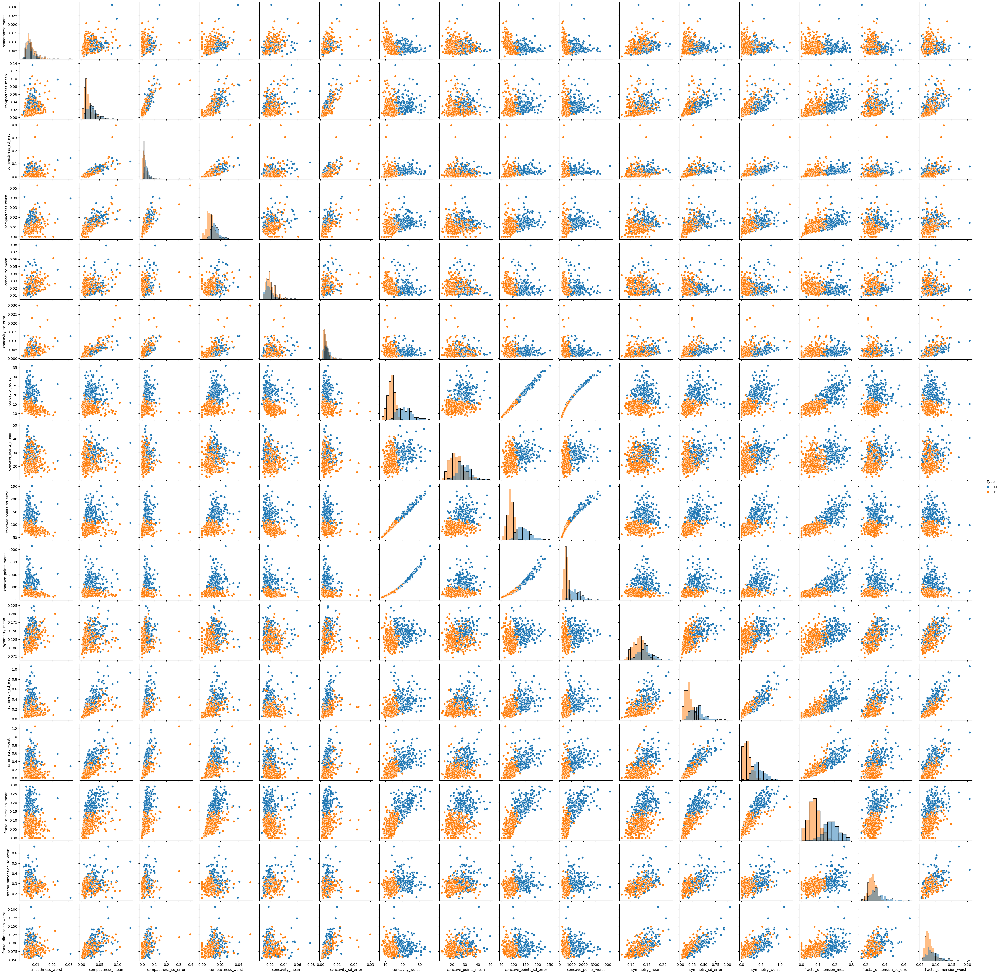

In [11]:
# An interesting visualization to see the distribution of features that results in different classes malignant or benign
df_full= df_bc.copy(deep=True)
df_full['Type']= y 

# For the ease of visualization only some features are selected 
n_pivot= 15
# df_full= add_columns(df_bc_feat, col)
# sns.pairplot(df_full.iloc[:, :n_pivot], hue= 'Type', diag_kind="hist")
sns.pairplot(df_full.iloc[:, n_pivot:], hue= 'Type', diag_kind="hist")

# sns.pairplot(df_full.iloc[:, 20:], hue= 'Type')
# df_full['Type'].value_counts()

##### The graph above provides an insightful visualization of distribution of malignant or benign classes with repect to different pairs of features. Some feature-pairs have distinctive (often visually) pattern with the target variable. These should be more explainable.   

In [12]:
# Compute the mean and median smoothness and compactness for malignant tumors
df_bc_mean_mal = df_full[df_full.Type == 'M'].mean()
df_bc_mean_mal[['smoothness_mean', 'smoothness_sd_error', 'compactness_mean', 'compactness_sd_error']]

ID
smoothness_mean          4.303716
smoothness_sd_error     72.289810
compactness_mean         0.032202
compactness_sd_error     0.041768
dtype: float64

In [13]:
#Compute the mean and median smoothness and compactness for benign
df_bc_mean_ben = df_full[df_full.Type == 'B'].mean()
df_bc_mean_ben[['smoothness_mean', 'smoothness_sd_error', 'compactness_mean', 'compactness_sd_error']]

ID
smoothness_mean          2.000321
smoothness_sd_error     21.135148
compactness_mean         0.021438
compactness_sd_error     0.025997
dtype: float64

In [25]:
# Mean value of all the features for ['benign'= 1, 'malignant'= 0] 
df_bc_mean_all= pd.DataFrame(data= [df_bc_mean_mal, df_bc_mean_ben]) 
print(df_bc_mean_all.T)

                                       0             1
ID                                                    
diagnosis                   3.698855e+07  2.654382e+07
radius_mean                 1.746033e+01  1.214652e+01
radius_sd_error             2.165810e+01  1.791476e+01
radius_worst                1.153301e+02  7.807541e+01
texture_mean                9.782692e+02  4.627902e+02
texture_sd_error            1.028250e-01  9.247765e-02
texture_worst               1.445602e-01  8.008462e-02
perimeter_mean              1.601144e-01  4.605762e-02
perimeter_sd_error          8.770986e-02  2.571741e-02
perimeter_worst             1.926768e-01  1.741860e-01
area_mean                   6.260412e-02  6.286739e-02
area_sd_error               6.067796e-01  2.840824e-01
area_worst                  1.212363e+00  1.220380e+00
smoothness_mean             4.303716e+00  2.000321e+00
smoothness_sd_error         7.228981e+01  2.113515e+01
smoothness_worst            6.781900e-03  7.195902e-03
compactnes

Smoothness_mean and smoothness_sd_error are much higher for malignant tumors. This may be an explainable factor for classification.

In [26]:
# Creation of train and test dataset
X_train, X_test, y_train, y_test = train_test_split(df_bc, y, test_size=0.25, random_state=7)

In [27]:
print('Training Features Shape:', X_train.shape)
print('Training Labels Shape:', y_train.shape)
print('Testing Features Shape:', X_test.shape)
print('Testing Labels Shape:', y_test.shape)

Training Features Shape: (426, 31)
Training Labels Shape: (426,)
Testing Features Shape: (142, 31)
Testing Labels Shape: (142,)


In [30]:
# function to generate bootstrap samples of the data

def bootstrap(X, y, n_samples=4):
    X_b, y_b = resample(X, y, n_samples=4, random_state=7)
    
    return X_b, y_b
X= df_bc
X_b, y_b= bootstrap(X, y, 10)

# print('Bootstrap Sample: %s' % X_b)
# print(X_b.shape)
print(y_b)

175    B
196    M
537    B
502    M
Name: M, dtype: object


## Implementation of Model: Logistic Regression

In [31]:
# Data preprocessing: Perform simple data transformation
# Standardize features by removing the mean and scaling to unit variance
from sklearn import linear_model

scal = StandardScaler()
X_train1 = scal.fit_transform(X_train)
X_test1 = scal.transform(X_test)

In [32]:
# Encode the categorical features 
y_train = pd.Categorical(y_train).codes
y_test = pd.Categorical(y_test).codes

In [33]:
# Fit a logistic regression model
reg = linear_model.LogisticRegression(C=1e7)
reg.fit(X_train1, y_train)

LogisticRegression(C=10000000.0)

In [34]:
# Predict on the test data
y_pred_test_lgr = reg.predict(X_test1)

# Compute accuracy
acc_lgr = np.mean(y_pred_test_lgr == y_test)
print("Accuracy on test data = %f" % acc_lgr)

Accuracy on test data = 0.964789


In [35]:
# Compute the slope of different features. This is inbuilt in this implementation in sklearn 
W=reg.coef_
data = {'feature': df_bc.columns, 'slope': np.squeeze(W)}
dfslope = pd.DataFrame(data=data)
dfslope.head()

,feature,slope
0,diagnosis,18.728233
1,radius_mean,-126.615088
2,radius_sd_error,-108.447484
3,radius_worst,-82.331548
4,texture_mean,-31.149762


Text(0, 0.5, 'TPR')

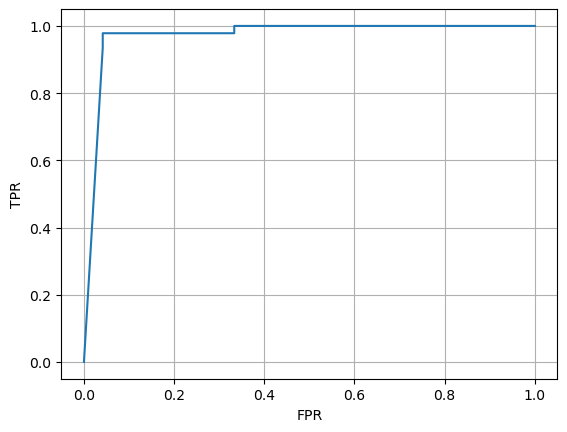

In [36]:
# Predict probability on the test data
y_prob = reg.predict_proba(X_test1)


# Compute FPR and TPR
fpr, tpr, thresholds = metrics.roc_curve(y_test, y_prob[:,1])

plt.plot(fpr,tpr)
plt.grid()
plt.xlabel('FPR')
plt.ylabel('TPR')
# plt.ylim([0.5,1])
# plt.xlim([0,0.1])

(0.0, 1.0)

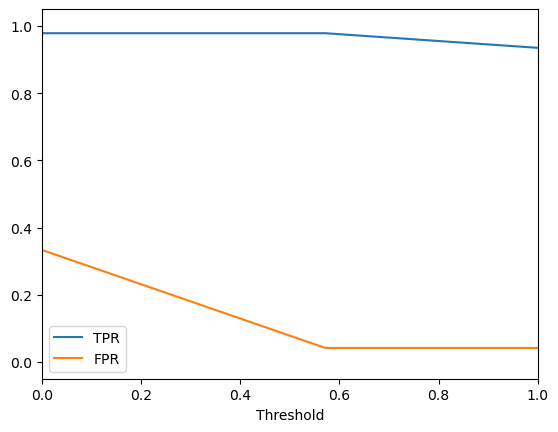

In [37]:
plt.plot(thresholds,tpr, thresholds,fpr)
plt.legend(['TPR','FPR'])
plt.xlabel('Threshold')
plt.xlim([0, 1])

In [38]:
# compute the area under curve

auc=metrics.roc_auc_score(y_test, y_prob[:,1])
print("AUC=%f" % auc)

AUC=0.971467


In [39]:
#Compute the confusion matrix

cm_lr= confusion_matrix(y_test, y_pred_test_lgr).T
print(classification_report(y_test, y_pred_test_lgr, target_names=['B', 'M']))

              precision    recall  f1-score   support

           B       0.99      0.96      0.97        96
           M       0.92      0.98      0.95        46

    accuracy                           0.96       142
   macro avg       0.95      0.97      0.96       142
weighted avg       0.97      0.96      0.97       142



## Implementation of Model: Decision Tree

In [40]:
# Create a decision tree object with default parameters and fit the training set

dtree_vanilla = tree.DecisionTreeClassifier()
dtree_vanilla.fit(X_train,y_train)

DecisionTreeClassifier()

In [41]:
# Compute the cross validation score for cv=5 

X= df_bc

cross_val_score(dtree_vanilla, 
                X, 
                y,
                scoring="accuracy", 
                cv=5).mean()

0.9172799254774103

In [42]:
# Visualization of decision tree, Use dot file to create a graph
export_graphviz(dtree_vanilla, out_file = 'dtree_vanilla.dot', feature_names = X.columns, rounded = True, precision = 1)

# Write graph and save to a png file
(graph_vanilla, ) = pydot.graph_from_dot_file('dtree_vanilla.dot')
graph_vanilla.write_png('dtree_vanilla.png')

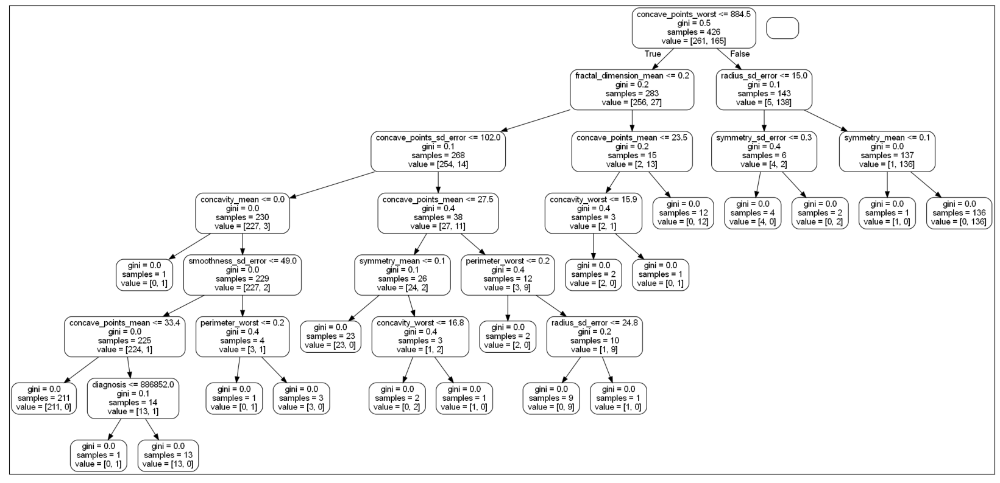

In [43]:
#Plot and save the decision tree
import matplotlib.pyplot as plt

def plot_decisiontree(img_name):
    tree_image = plt.imread(img_name)
    plt.figure(figsize=(100,10))
    plt.xticks([])
    plt.yticks([])
    plt.imshow(tree_image)
    plt.show()
plot_decisiontree('dtree_vanilla.png')

In [44]:
#Prediction on training again to see the training error
y_pred_train = np.array(dtree_vanilla.predict(X_train))

In [45]:
# Compute the training error
train_error = abs(y_pred_train - y_train)
print("Mean Absolute Error for Train: ", round(np.mean(train_error),2))


Mean Absolute Error for Train:  0.0


In [46]:
# Predict class on the test set
y_pred_test = dtree_vanilla.predict(X_test)
y_pred_test= pd.Categorical(y_pred_test).codes


# Compute the test error
y_test = pd.Categorical(y_test).codes
test_error = abs(y_pred_test - y_test)
print("Mean Absolute Error for test: ", round(np.mean(test_error),2))

Mean Absolute Error for test:  0.04


In [47]:
# Compute the contribution from different features for the decision tree model
feature_list= X.columns

# Get numerical feature importances
importances = list(dtree_vanilla.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]

# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

Variable: concave_points_worst Importance: 0.71
Variable: fractal_dimension_mean Importance: 0.09
Variable: concave_points_mean  Importance: 0.05
Variable: radius_sd_error      Importance: 0.03
Variable: perimeter_worst      Importance: 0.02
Variable: concave_points_sd_error Importance: 0.02
Variable: symmetry_mean        Importance: 0.02
Variable: diagnosis            Importance: 0.01
Variable: concavity_mean       Importance: 0.01
Variable: concavity_worst      Importance: 0.01
Variable: symmetry_sd_error    Importance: 0.01
Variable: radius_mean          Importance: 0.0
Variable: radius_worst         Importance: 0.0
Variable: texture_mean         Importance: 0.0
Variable: texture_sd_error     Importance: 0.0
Variable: texture_worst        Importance: 0.0
Variable: perimeter_mean       Importance: 0.0
Variable: perimeter_sd_error   Importance: 0.0
Variable: area_mean            Importance: 0.0
Variable: area_sd_error        Importance: 0.0
Variable: area_worst           Importance: 0

#### As per the feature improtance analysis given above concave_points_worst is the factor most strongly associated with the tumor type. The variable importance score of other features are much less as compared to that of 'concave_points_worst'. Later, in case of ensemble methods we will see a moderately different distribution of future importance score. 

In [48]:
# Compute the confusion matrix and print the classification report
cm_dt= confusion_matrix(y_test, y_pred_test).T
print(classification_report(y_test, y_pred_test, target_names=['B', 'M']))

              precision    recall  f1-score   support

           B       0.98      0.96      0.97        96
           M       0.92      0.96      0.94        46

    accuracy                           0.96       142
   macro avg       0.95      0.96      0.95       142
weighted avg       0.96      0.96      0.96       142



## Implementation of Model: Random Forest

In [49]:
# Crate an rf object using sklearn library and fit the training data
rf = RandomForestClassifier(n_estimators = 100, 
                           min_samples_leaf=5, 
                           max_depth=5, 
                           random_state = 7)
rf.fit(X_train, y_train)

RandomForestClassifier(max_depth=5, min_samples_leaf=5, random_state=7)

In [50]:
# Compute train and test error
y_pred_train_rf = rf.predict(X_train)
train_error_rf = abs(y_pred_train_rf - y_train)
print("Mean Absolute Error for Train: ", round(np.mean(train_error_rf),2))

y_pred_test_rf = rf.predict(X_test)
test_error_rf = abs(y_pred_test_rf - y_test)
print("Mean Absolute Error for test: ", round(np.mean(test_error_rf),2))

Mean Absolute Error for Train:  0.02
Mean Absolute Error for test:  0.04


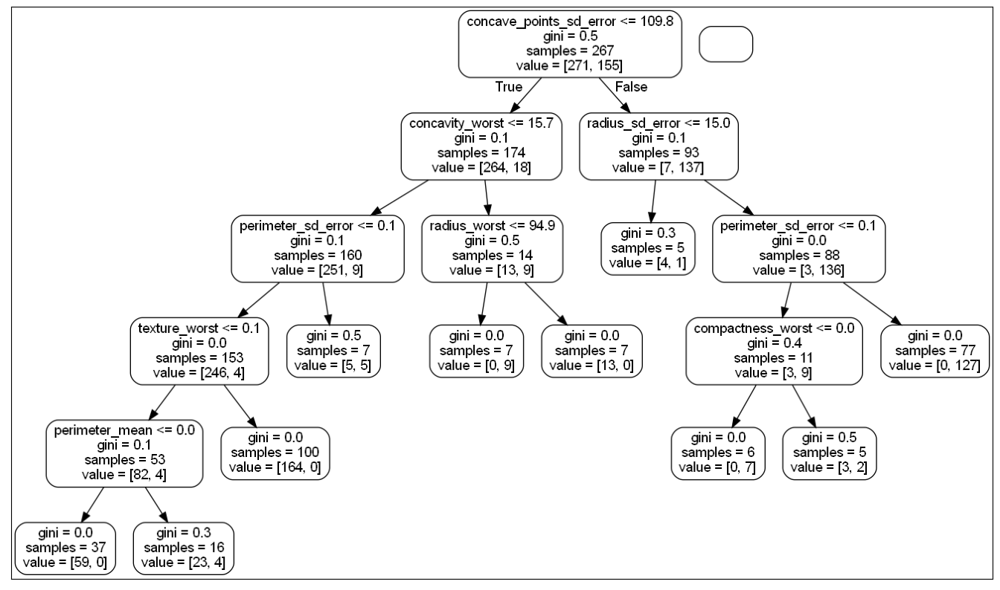

In [51]:
# Visualize the model and save as a figure
rf_tree = rf.estimators_[5]
export_graphviz(rf_tree, out_file = 'rf.dot', feature_names = feature_list, rounded = True, precision = 1)
# Write graph to a png file
(graph_rf, ) = pydot.graph_from_dot_file('rf.dot')
graph_rf.write_png('rf.png')
plot_decisiontree('rf.png')

In [52]:
# Get numerical feature importances
importances = list(rf.feature_importances_)
# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]
# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

Variable: concavity_worst      Importance: 0.15
Variable: concave_points_worst Importance: 0.15
Variable: concave_points_sd_error Importance: 0.11
Variable: perimeter_sd_error   Importance: 0.09
Variable: fractal_dimension_mean Importance: 0.09
Variable: radius_worst         Importance: 0.06
Variable: texture_mean         Importance: 0.06
Variable: smoothness_sd_error  Importance: 0.06
Variable: symmetry_worst       Importance: 0.05
Variable: radius_mean          Importance: 0.04
Variable: texture_worst        Importance: 0.02
Variable: perimeter_mean       Importance: 0.02
Variable: area_sd_error        Importance: 0.02
Variable: radius_sd_error      Importance: 0.01
Variable: smoothness_mean      Importance: 0.01
Variable: compactness_worst    Importance: 0.01
Variable: concave_points_mean  Importance: 0.01
Variable: symmetry_mean        Importance: 0.01
Variable: symmetry_sd_error    Importance: 0.01
Variable: fractal_dimension_sd_error Importance: 0.01
Variable: diagnosis          

#### In this case the top 5 features are: concavity_worst, concave_points_worst, concave_points_sd_error, perimeter_sd_error, fractal_dimension_mean. Previously, with decision tree we saw that 'concave_points_worst' turns out to be the most important feature. For random forest also top three features are related to concavity that captures the curvature of the lump. 

##### Moreover, this analysis demonstrates that different methods for calculating feature importance score may result in different scores assigned to respective features. However, there will be some alignment in practice.

In [53]:
#Compute the confusion matrix and print the classification report
cm_rf= confusion_matrix(y_test, y_pred_test_rf).T
print(classification_report(y_test, y_pred_test_rf, target_names=['B', 'M']))

              precision    recall  f1-score   support

           B       0.98      0.97      0.97        96
           M       0.94      0.96      0.95        46

    accuracy                           0.96       142
   macro avg       0.96      0.96      0.96       142
weighted avg       0.97      0.96      0.96       142



#### It is observed that all the three models implemented, namely, i) logistic regression, ii) decision tree, and iii) random forest produce similar accuracy, precision, recall and f1 score all~0.95 

# Part 2: Feedback

## Student Sample-1

### Code

Most popular libraries are selected that includes sklearn, pandas, numpy. The coding style is Ok. However, it can be improved further. 

It seems there are some errors related to import. For the reproductionability it may be good to provide the version details. The student may go through the API documentation to improve the understanding. With sklearn 1.1.1 the import functions don't match with the code. 
There are some errors related to import. 
from sklearn import LinearRegression is to be changed to:
from sklearn.linear_model import LinearRegression
from sklearn.cross_validation import cross_val_score is to be changed to:
from sklearn.model_selection import cross_val_score

It would be good to follow the notational conventions. Usually the target variable is denoted as y and the feature set is denoted as X. Follwoing the conventions reduces number of errors and improves the coding skill.

It would be good to use comments in the code. This will improve readibility and refer at a later point in time. It would also be necessary while working and collaborating with others in a bigger project.

#### The correct executable code is:

import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.metrics import mean_absolute_error

data= pd.read_csv('../part-2-dataset/part-2-data.train.csv')

x1 = data.SalaryNormalized
x2 = pd.get_dummies(data.ContractType)

model = LinearRegression()

scores = cross_val_score(model, x2, x1, cv= 2, scoring='neg_mean_absolute_error')
print(scores.mean())

### Methodology

Understanding of the methodology is ok. However, there are scope of improvements. The following may be noted:

Only one feature is used, may be many features are to be tried. A standard feature selection method (linear, tree based etc) may be used to select some of the important features. 

May try a different cross validation and see if the result changes a lot. 

### Conceptual Understanding

Understanding of the methodology is ok. However, there are scope of improvements

Get dummies function is used to convert categorical variable into dummy/indicator variables. Understanding on the concept of feature selection may be improved. Why do we need feature selection methods, what is a good feature selection, how to validate that, these are some of the concepts good to have.

Also, the concept of cross validation may be improved. Seems cv=2 may not be very appropriate as it may not give enough instances to evaluate the model. A higher cv score will be better. The student may revisit through the concept of cross validation once again. 

## Student Sample-2
### Code

Most popular libraries are selected that includes sklearn, pandas, numpy. The coding style is fairly Good.

For the reproductionability it may be good to provide the version details. The student may go through the API documentation of the libraries being used to improve the familiarity. With sklearn 1.1.1 the import functions dont match with the code. 
There are some errors related to import. 

It would be good to use comments in the code. This will improve readibility and refer at a later point in time. It would also be necessary while working and collaborating with others in a bigger project.  

### Methodology

Understanding of the methodology is ok. However, there are scope of improvements. The following may be noted:

Only one feature is used, may be many features are to be tries. A standard feature selection method (linear, tree based etc) may be used to select some of the important features. 

May try a different cross validation and see if the result changes a lot.

### Conceptual Understanding

Understanding of the methodology is ok. However, there are scope of improvements. Some data transformations may produce better results. The concepts of data data transformations and the inherent assumptions of linear regression may be reviewed. 

Get dummies function is used to convert categorical variable into dummy/indicator variables. Concepts related to feature selection and engineering may be improved.